# **DATA SCIENCE WEEKLY - NEWSLETTER CONVERSION RATE PREDICTION**
### **Bloc 03: MACHINE LEARNING**

---

### Import libraries

In [1]:
import pandas as pd
import numpy as np

# Preprocessing and model selection libraries
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import StandardScaler, OneHotEncoder
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import OneHotEncoder
from sklearn.pipeline import Pipeline
from sklearn.metrics import f1_score, confusion_matrix, ConfusionMatrixDisplay, accuracy_score, RocCurveDisplay, classification_report

# Machine learning libraries
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier, BaggingClassifier, AdaBoostClassifier, GradientBoostingClassifier
from xgboost import XGBClassifier
from sklearn.model_selection import GridSearchCV

# Visualization libraries
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px
import plotly.graph_objects as go
import plotly.figure_factory as ff
from plotly.subplots import make_subplots
import plotly.io as pio

# Jedha color palette as default
pio.templates["jedha"] = go.layout.Template(
    layout_colorway=["#4B9AC7", "#4BE8E0", "#9DD4F3", "#97FBF6", "#2A7FAF", "#23B1AB", "#0E3449", "#015955"]
)
pio.templates.default = "jedha"

### Read file with labels

In [2]:
data = pd.read_csv(r'conversion_data_train.csv')

---

# **PART 1 | Exploratory Data Analysis (EDA)**

## 1. Basic infos and statistics

In [3]:
# Basic information about the dataset with labels
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 284580 entries, 0 to 284579
Data columns (total 6 columns):
 #   Column               Non-Null Count   Dtype 
---  ------               --------------   ----- 
 0   country              284580 non-null  object
 1   age                  284580 non-null  int64 
 2   new_user             284580 non-null  int64 
 3   source               284580 non-null  object
 4   total_pages_visited  284580 non-null  int64 
 5   converted            284580 non-null  int64 
dtypes: int64(4), object(2)
memory usage: 13.0+ MB


In [4]:
# First few rows of the dataframe
data.head()

,country,age,new_user,source,total_pages_visited,converted
0,China,22,1,Direct,2,0
1,UK,21,1,Ads,3,0
2,Germany,20,0,Seo,14,1
3,US,23,1,Seo,3,0
4,US,28,1,Direct,3,0


In [5]:
# Detailed statistics of the dataset
data.describe()

,age,new_user,total_pages_visited,converted
count,284580.000000,284580.000000,284580.000000,284580.000000
mean,30.564203,0.685452,4.873252,0.032258
std,8.266789,0.464336,3.341995,0.176685
min,17.000000,0.000000,1.000000,0.000000
25%,24.000000,0.000000,2.000000,0.000000
50%,30.000000,1.000000,4.000000,0.000000
75%,36.000000,1.000000,7.000000,0.000000
max,123.000000,1.000000,29.000000,1.000000


In [6]:
# Detecting anomalies in the 'age' column and removing them from the dataset.

age_to_drop = data[data['age'] > 100]

print(f"Number of rows with 'age' > 100: {len(age_to_drop)}")
print("\nDetail of rows to drop:")
print(age_to_drop.head())

data_clean = data[data['age'] <= 100].copy()
print(f"\nMaximum age after cleaning: {data_clean['age'].max()}")

data = data_clean

Number of rows with 'age' > 100: 2

Detail of rows to drop:
        country  age  new_user source  total_pages_visited  converted
11331        UK  111         0    Ads                   10          1
233196  Germany  123         0    Seo                   15          1

Maximum age after cleaning: 79


In [7]:
# Statistics for categorical variables
data.describe(include=['object'])

,country,source
count,284578,284578
unique,4,3
top,US,Seo
freq,160124,139476


In [8]:
# Conversion columns to 'category' dtype 
# new_user is binary categorical feature, we convert it as well

categorical_features = ['country', 'source', 'new_user']

for col in categorical_features:
	data[col] = data[col].astype('category')

# Check the data types after conversion
print(data.dtypes)

country                category
age                       int64
new_user               category
source                 category
total_pages_visited       int64
converted                 int64
dtype: object


## 2. Visualizations

In [9]:
# Histogram of user distribution by country according to their conversion status
fig_country1 = px.histogram(
    data_frame=data,
    x=["country"],
    color="converted",
    barmode='group',
    title=f'User distribution by country and conversion status'
)
fig_country1.update_yaxes(title='')
fig_country1.update_xaxes(title='')
fig_country1.show()

# Average conversion rate per country
conversion_rate_country = data.groupby('country', observed=True)['converted'].mean().reset_index(name='conversion_rate')
conversion_rate_country['conversion_rate_pct'] = conversion_rate_country['conversion_rate'] * 100

# Histogram of conversion rate percentage for each country
fig_country2 = px.bar(
    conversion_rate_country,
    x='country',
    y='conversion_rate_pct',
    text='conversion_rate_pct', 
    title='Conversion rate (%) by country',
    labels={'conversion_rate_pct': 'Convertion rate (%)', 'country': 'Country'},
    color='country'
)
fig_country2.update_traces(texttemplate='%{y:.2f}%', textposition='outside')
fig_country2.update_yaxes(title='Conversion rate (%)', range=[0, conversion_rate_country['conversion_rate_pct'].max() * 1.2])
fig_country2.show()

**Most users come from the United States and China**, but **conversion rates** remain **low** in these markets. \
**Germany** and the **United Kingdom**, although accounting for a **smaller user base**, show significantly **higher conversion rates**, suggesting stronger user engagement in these countries.

In [10]:
# Histogram of the distribution of existing and new users split by conversion status
fig_new_user1 = px.histogram(
    data_frame=data,
    x=["new_user"],
    color="converted",
    barmode='group',
    title=f'Distribution of existing and new users by conversion status'
)
fig_new_user1.update_xaxes(
    tickvals=[0, 1],
    ticktext=['Existing user (new_user=0)', 'New user (new_user=1)'],
    title_text="User status"
)
fig_new_user1.show()

# Average conversion rate per new_user
conversion_rate_new_user = data.groupby('new_user', observed=True)['converted'].mean().reset_index(name='conversion_rate')
conversion_rate_new_user['conversion_rate_pct'] = conversion_rate_new_user['conversion_rate'] * 100

# Histogram of conversion rate percentage for existing and new users
fig_new_user2 = px.bar(
    conversion_rate_new_user,
    x='new_user',
    y='conversion_rate_pct',
    text='conversion_rate_pct', 
    title='Conversion rate (%) by new_user',
    labels={'conversion_rate_pct': 'Convertion rate (%)', 'new_user': 'new_user'},
    color='new_user'
)
fig_new_user2.update_traces(texttemplate='%{y:.2f}%', textposition='outside')
fig_new_user2.update_yaxes(title='Conversion rate (%)', range=[0, conversion_rate_new_user['conversion_rate_pct'].max() * 1.2])
fig_new_user2.show()

**Existing users** represent a **smaller share** of the total base but show a **much higher conversion rate (7.2% vs. 1.4%)**. 

In [11]:
# Histogram of the distribution of sources split by conversion status
fig_source1 = px.histogram(
    data_frame=data,
    x=["source"],
    color="converted",
    barmode='group',
    title=f'Distribution of sources by conversion status'
)
fig_source1.update_yaxes(title='')
fig_source1.update_xaxes(title='')
fig_source1.show()

# Average conversion rate per source
conversion_rate_source = data.groupby('source', observed=True)['converted'].mean().reset_index(name='conversion_rate')
conversion_rate_source['conversion_rate_pct'] = conversion_rate_source['conversion_rate'] * 100

# Histogram of conversion rate percentage for sources
fig_source2 = px.bar(
    conversion_rate_source,
    x='source',
    y='conversion_rate_pct',
    text='conversion_rate_pct', 
    title='Conversion rate (%) by source',
    labels={'conversion_rate_pct': 'Convertion rate (%)', 'source': 'source'},
    color='source'
)
fig_source2.update_traces(texttemplate='%{y:.2f}%', textposition='outside')
fig_source2.update_yaxes(title='Conversion rate (%)', range=[0, conversion_rate_source['conversion_rate_pct'].max() * 1.2])
fig_source2.show()

**Most users come from organic search (SEO)**, but overall **conversion rates are quite similar across channels**. \
**Ads perform slightly better** with a 3.5% conversion rate, while direct traffic shows a somewhat lower performance.

In [12]:
# Histogram of the distribution of ages by conversion status
fig_age1 = px.histogram(
    data_frame=data,
    x='age',
    color="converted",
    title=f'Distribution of ages by conversion status',
    opacity=0.7,
    #nbins=40
    )
fig_age1.update_yaxes(title='')
fig_age1.update_xaxes(title='')
fig_age1.show()

# Average conversion rate per age
conversion_rate_age = data.groupby('age', observed=True)['converted'].mean().reset_index(name='conversion_rate')
conversion_rate_age['conversion_rate_pct'] = conversion_rate_age['conversion_rate'] * 100

# Histogram of conversion rate percentage by age
fig_age2 = px.bar(
    conversion_rate_age,
    x='age',
    y='conversion_rate_pct',
    text='conversion_rate_pct', 
    title='Conversion rate (%) by age',
    labels={'conversion_rate_pct': 'Convertion rate (%)', 'age': 'age'},
    color='age'
)
fig_age2.update_traces(texttemplate='%{y:.2f}%', textposition='outside')
fig_age2.update_yaxes(title='Conversion rate (%)', range=[0, conversion_rate_age['conversion_rate_pct'].max() * 1.2])
fig_age2.show()

The **user base** is mainly concentrated between **20 and 35 years old**, peaking around 28–30 years.\
The **conversion rate decreases steadily with age**, dropping from over **7% among the youngest users** to below **2% after 35**.\
The small rebound observed around 60 years old is not meaningful statistically: user counts in this range are very low, so even a handful of conversions can artificially inflate the rate.

Overall, the pattern still seems to indicate a clear **negative relationship between age and conversion**, with younger users being significantly more likely to convert.

In [13]:
# Histogram of the distribution of total pages visited by conversion status
fig_total_pages_visited1 = px.histogram(
    data_frame=data,
    x='total_pages_visited',
    color="converted",
    title=f'Distribution of total pages visited by conversion status',
    opacity=0.7,
    )
fig_total_pages_visited1.update_yaxes(title='')
fig_total_pages_visited1.update_xaxes(title='')
fig_total_pages_visited1.show()

# Average conversion rate per total_pages_visited
conversion_rate_total_pages_visited = data.groupby('total_pages_visited', observed=True)['converted'].mean().reset_index(name='conversion_rate')
conversion_rate_total_pages_visited['conversion_rate_pct'] = conversion_rate_total_pages_visited['conversion_rate'] * 100

# Histogram of conversion rate percentage by total_pages_visited
fig_total_pages_visited2 = px.bar(
    conversion_rate_total_pages_visited,
    x='total_pages_visited',
    y='conversion_rate_pct',
    text='conversion_rate_pct', 
    title='Conversion rate (%) by total_pages_visited',
    labels={'conversion_rate_pct': 'Convertion rate (%)', 'total_pages_visited': 'total_pages_visited'},
    color='total_pages_visited'
)
fig_total_pages_visited2.update_traces(texttemplate='%{y:.2f}%', textposition='outside')
fig_total_pages_visited2.update_yaxes(title='Conversion rate (%)', range=[0, conversion_rate_total_pages_visited['conversion_rate_pct'].max() * 1.2])
fig_total_pages_visited2.show()

**Most users view only a few pages** and their **conversion rate** is **very low**. \
However, **the more pages a user visits, the higher the conversion rate**, becoming almost systematic after around 15 pages.

***We should be cautious though: very high pageview counts concern only a small number of users, so those high rates are based on limited data.*** \
These values ​may be winsorized (capped) before modeling to prevent them from biasing the coefficients.

In [ ]:
# Correlations with target ("converted")

target = 'converted'

METHOD = 'spearman'

y = data[target]

X = data.drop(columns=[target])
X = pd.get_dummies(X, drop_first=True)
X = X.apply(pd.to_numeric, errors='coerce')

corrs = X.corrwith(y, method=METHOD).dropna()
abs_corrs = corrs.abs().sort_values(ascending=False)
corr_df = corrs.loc[abs_corrs.index].rename('corr').reset_index().rename(columns={'index': 'feature'})
corr_df['abs_corr'] = corr_df['corr'].abs()
corr_df_sorted = corr_df.sort_values('abs_corr')

colors = np.where(corr_df_sorted['corr'] >= 0, '#66C5CC', '#FE88B1') # cyan for positive, pink for negative

fig = px.bar(
    corr_df_sorted,
    x='abs_corr', y='feature', orientation='h',
    title=f'Correlations with target (|{METHOD}|)',
    labels={'abs_corr': '|correlation|', 'feature': 'Feature'}
)
fig.update_traces(marker_color=colors)
fig.update_yaxes(title='')
fig.update_layout(margin=dict(t=60, r=100, l=200, b=80), height=500)
fig.show()


The Spearman correlation ( $|\rho_s|$ ) analysis suggests that **the most critical factor for conversion is the total number of pages visited** (total_pages_visited), showing a strong positive correlation. \
**User status** (new vs. existing) exhibit **moderate associations**. \
Conversely, traffic sources display much weaker correlations.

Although the **EDA clearly revealed a relationship between age and conversion** (with conversion rates decreasing as age increases) the **Spearman correlation remains low**.\
This is due to the non-linear nature of the relationship: conversion does not change monotonically with age but rather follows a declining curve that levels off.\
These values ​​should therefore be interpreted with caution and may be winsorized (capped) before modeling to prevent them from biasing the coefficients.

## 3. Winsorization

In [15]:
# Winsorizing the 'age' column using the 99,9th percentile, to limit the influence of extreme values on modeling.

upper_bound_age = data['age'].quantile(0.999)
len_above_upper = (data['age'] > upper_bound_age).sum()
print(f"Number of rows with 'age' above 99,9th percentile ({upper_bound_age:.2f}): {len_above_upper}")


data.loc[data['age'] > upper_bound_age, 'age'] = upper_bound_age
print(f"Max age after capping: {data['age'].max()}")

Number of rows with 'age' above 99,9th percentile (60.00): 205
Max age after capping: 60


In [16]:
# Winsorizing the 'total_pages_visited' column to cap extreme values at the 99,7th percentile, as it shows a long tail distribution.

upper_bound_pages = data['total_pages_visited'].quantile(0.997)
len_above_upper = (data['total_pages_visited'] > upper_bound_pages).sum()
print(f"Number of rows with 'total_pages_visited' above 99,7th percentile ({upper_bound_pages:.2f}): {len_above_upper}")


data.loc[data['total_pages_visited'] > upper_bound_pages, 'total_pages_visited'] = upper_bound_pages
print(f"Max pages visited after capping: {data['age'].max()}")

Number of rows with 'total_pages_visited' above 99,7th percentile (20.00): 626
Max pages visited after capping: 60


---

# **PART 2 | Baseline model** (Jedha template)

## 1. Selection of variables and splitting the dataset on train and test sets

In [17]:
# Selection of features and target variable for modeling

features_list = ['total_pages_visited']
numeric_indices = [0]
categorical_indices = []
target_variable = 'converted'

In [18]:
# Splitting dataset into explanatory variables (X) and target variable (Y)

X = data.loc[:, features_list]
Y = data.loc[:, target_variable]

print('Explanatory variables : ', X.columns)

Explanatory variables :  Index(['total_pages_visited'], dtype='object')


In [19]:
# Divide dataset train set & test set 

print("Dividing into train and test sets...")

X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.1, random_state=0)
print("...Done.")

Dividing into train and test sets...
...Done.


## 2. Training pipeline

In [20]:
# Preprocessings on train set

print("Encoding categorical features and standardizing numerical features...")

featureencoder = StandardScaler()
X_train = featureencoder.fit_transform(X_train)
print("...Done")
print(X_train[0:5,:])

Encoding categorical features and standardizing numerical features...
...Done
[[ 0.34133292]
 [ 0.0398272 ]
 [-0.86468998]
 [ 0.34133292]
 [-0.26167853]]


In [21]:
# Train model

print("Train model...")
classifier = LogisticRegression() # 
classifier.fit(X_train, Y_train)
print("...Done.")

Train model...
...Done.


In [22]:
# Predictions on training set

print("Predictions on training set...")
Y_train_pred = classifier.predict(X_train)
print("...Done.")
print(Y_train_pred)
print()

Predictions on training set...
...Done.
[0 0 0 ... 0 0 0]



## 3. Test pipeline

In [23]:
# Preprocessings on test set

print("Encoding categorical features and standardizing numerical features...")

X_test = featureencoder.transform(X_test)
print("...Done")
print(X_test[0:5,:])

Encoding categorical features and standardizing numerical features...
...Done
[[ 0.64283865]
 [-0.86468998]
 [-1.16619571]
 [-0.86468998]
 [ 0.94434438]]


In [24]:
# Predictions on test set

print("Predictions on test set...")
Y_test_pred = classifier.predict(X_test)
print("...Done.")
print(Y_test_pred)
print()

Predictions on test set...
...Done.
[0 0 0 ... 0 0 0]



## 4. Performance assessment

In [25]:
# F1-score performance assessment

print("f1-score on train set : ", f1_score(Y_train, Y_train_pred))
print("f1-score on test set : ", f1_score(Y_test, Y_test_pred))

f1-score on train set :  0.6957985550957424
f1-score on test set :  0.6893203883495146


**The baseline model reaches a f1-score of almost 70% on train and test sets.**

Confusion matrix on train set : 


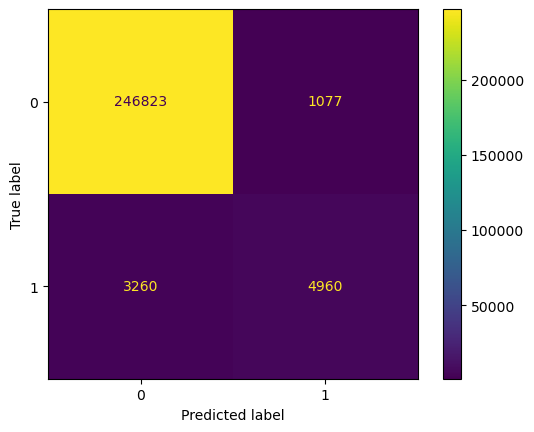


Confusion matrix on test set : 


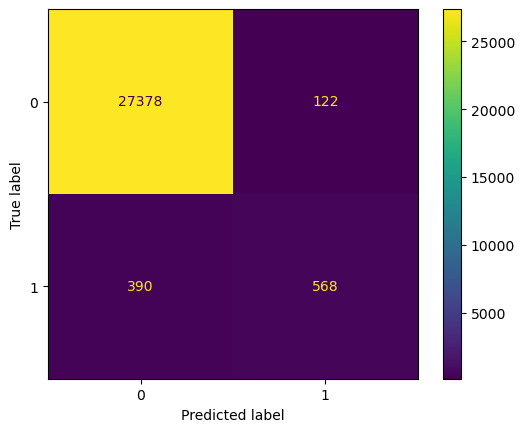

In [26]:
# Confusion matrices with display

print("Confusion matrix on train set : ")
confmat_train = confusion_matrix(Y_train, Y_train_pred)
disp_train = ConfusionMatrixDisplay(confusion_matrix=confmat_train, display_labels=classifier.classes_)
disp_train.plot()
plt.show()
print()
print("Confusion matrix on test set : ")
confmat_test = confusion_matrix(Y_test, Y_test_pred)
disp_test = ConfusionMatrixDisplay(confusion_matrix=confmat_test, display_labels=classifier.classes_)
disp_test.plot()
plt.show()

**The model performs well at identifying non-converted users (negative class)**, with a low false positive rate. \
However, the **number of false negatives remains significant**, indicating that some converted users are missed. \
The **consistency between train and test** results suggests reasonable generalization.

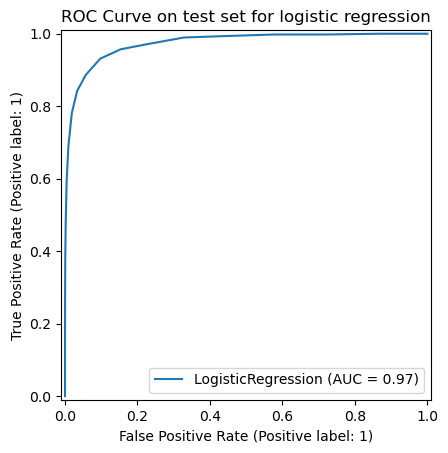

In [27]:
# ROC Curve on test set

_ , ax = plt.subplots() # Throwaway variable (figure_object) not used
ax.set(title="ROC Curve on test set for logistic regression")
RocCurveDisplay.from_estimator(classifier, X_test, Y_test, ax=ax)
plt.show()

The ROC curve demonstrates **very good discriminative performance of the model between positive and negative classes**. \
With an AUC (Area Under the Curve) of 0.97, the baseline model effectively separates converted from non-converted users on the test set.

---

# **PART 3 | Model improvement**

## 1. Feature engineering

In [28]:
# Creation of new features for model improvement through feature engineering.
# Use a numeric representation of 'new_user' for arithmetic while keeping the original column as-is.

new_user_num = pd.to_numeric(data['new_user'], errors='coerce').astype(int)

data['pages_per_age'] = data['total_pages_visited'] / (data['age'] + 1e-6) 
data['age_x_new_user'] = data['age'] * new_user_num
data['age_squared'] = data['age'] ** 2
data['pages_visited_x_new_user'] = data['total_pages_visited'] * new_user_num
data['log_pages_visited'] = np.log1p(data['total_pages_visited'])

## 2. Selection of variables and splitting the dataset on train and test sets

In [29]:
# Selection of features and target variable for improved modeling

features_list = ['country', 'age', 'new_user',  'source',  'total_pages_visited', 'pages_per_age', 'age_x_new_user', 'age_squared', 'pages_visited_x_new_user', 'log_pages_visited']
target_variable = 'converted'

In [30]:
# Splitting dataset into explanatory variables (X) and target variable (Y)

X = data.loc[:, features_list]
Y = data.loc[:, target_variable]

print('Explanatory variables : ', X.columns)
print()

Explanatory variables :  Index(['country', 'age', 'new_user', 'source', 'total_pages_visited',
       'pages_per_age', 'age_x_new_user', 'age_squared',
       'pages_visited_x_new_user', 'log_pages_visited'],
      dtype='object')



In [31]:
# Defining numeric and categorical features for preprocessing

numeric_features = ['age', 'total_pages_visited', 'pages_per_age', 'age_x_new_user', 'age_squared', 'pages_visited_x_new_user', 'log_pages_visited'] 
categorical_features =  ['country', 'new_user', 'source']

print("Found numeric features ", numeric_features)
print("Found categorical features ", categorical_features)

Found numeric features  ['age', 'total_pages_visited', 'pages_per_age', 'age_x_new_user', 'age_squared', 'pages_visited_x_new_user', 'log_pages_visited']
Found categorical features  ['country', 'new_user', 'source']


In [32]:
# Divide dataset train set and test set

print("Dividing into train and test sets...")
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.1, random_state=0)
print("...Done.")
print()

Dividing into train and test sets...
...Done.



## 3. Training pipeline - XGBoost

In [33]:
# Preprocessings on train set
preprocessor = ColumnTransformer([
    ("num", StandardScaler(), numeric_features),
    ("cat", OneHotEncoder(handle_unknown='ignore', drop='first'), categorical_features)
])

# Pipeline
xgb_pipeline = Pipeline(steps=[
    ('preprocessor', preprocessor),
    ('classifier', XGBClassifier(objective='binary:logistic', eval_metric='logloss', random_state=0))
])

# XGBoost hyperparameter grid for Grid Search
xgb_params = {
    'classifier__n_estimators': [135, 136, 138, 140],
    'classifier__learning_rate': [0.03, 0.04, 0.05],
    'classifier__max_depth': [6, 7, 8],
    'classifier__subsample': [0.4, 0.5, 0.6],
    'classifier__colsample_bytree': [0.9, 1]
}

# Grid Search with Cross-Validation for XGBoost
xgb_gridsearch = GridSearchCV(xgb_pipeline, param_grid=xgb_params, cv=3, verbose=1, scoring='f1')

# Training the best XGBoost model with Grid Search on train set
xgb_gridsearch.fit(X_train[features_list], Y_train)
# ou xgb_gridsearch.fit(X_train, Y_train)

Fitting 3 folds for each of 216 candidates, totalling 648 fits


GridSearchCV(cv=3,
             estimator=Pipeline(steps=[('preprocessor',
                                        ColumnTransformer(transformers=[('num',
                                                                         StandardScaler(),
                                                                         ['age',
                                                                          'total_pages_visited',
                                                                          'pages_per_age',
                                                                          'age_x_new_user',
                                                                          'age_squared',
                                                                          'pages_visited_x_new_user',
                                                                          'log_pages_visited']),
                                                                        ('cat',
                                                                         OneHotEncoder(drop='first',
                                                                                       handle_unknown='ignore'),
                                                                         ['country',
                                                                          'new_user',
                                                                          'source'])])),
                                       ('classifier',...
                                                      missing=nan,
                                                      monotone_constraints=None,
                                                      multi_strategy=None,
                                                      n_estimators=None,
                                                      n_jobs=None,
                                                      num_parallel_tree=None, ...))]),
             param_grid={'classifier__colsample_bytree': [0.9, 1],
                         'classifier__learning_rate': [0.03, 0.04, 0.05],
                         'classifier__max_depth': [6, 7, 8],
                         'classifier__n_estimators': [135, 136, 138, 140],
                         'classifier__subsample': [0.4, 0.5, 0.6]},
             scoring='f1', verbose=1)

In [34]:
# Final results 

print("Best XGBoost hyperparameters : ", xgb_gridsearch.best_params_)
print("Best XGBoost validation F1-score : ", xgb_gridsearch.best_score_)

Best XGBoost hyperparameters :  {'classifier__colsample_bytree': 1, 'classifier__learning_rate': 0.05, 'classifier__max_depth': 6, 'classifier__n_estimators': 135, 'classifier__subsample': 0.6}
Best XGBoost validation F1-score :  0.7668582721591001


## 4. Performance assessment

In [35]:
# Predictions with the best XGBoost model

best_pipeline_xgb = xgb_gridsearch.best_estimator_

Y_train_pred = best_pipeline_xgb.predict(X_train[features_list])
Y_test_pred  = best_pipeline_xgb.predict(X_test[features_list])

In [36]:
# F1-score performance assessment

print("XGBoost F1-score on training set : ", f1_score(Y_train, Y_train_pred))
print("XGBoost F1-score on test set : ", f1_score(Y_test, Y_test_pred))

XGBoost F1-score on training set :  0.7710507077822821
XGBoost F1-score on test set :  0.7507196315486471


The final tuned XGBoost model exhibits **stable and very competitive predictive capability**. \
The training F1-score of 0.771 and the test F1-score of 0.751 indicate **good generalization with minimal evidence of overfitting**.

Confusion matrix on train set : 


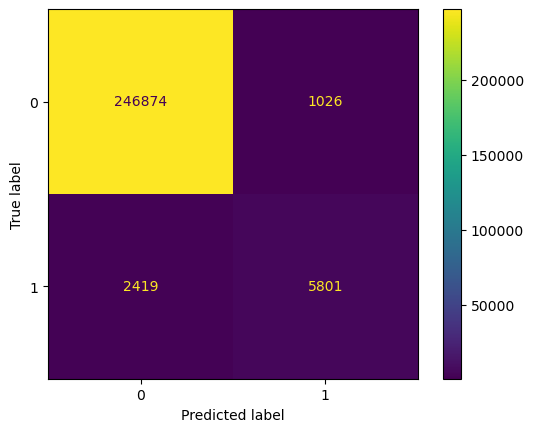


Confusion matrix on test set : 


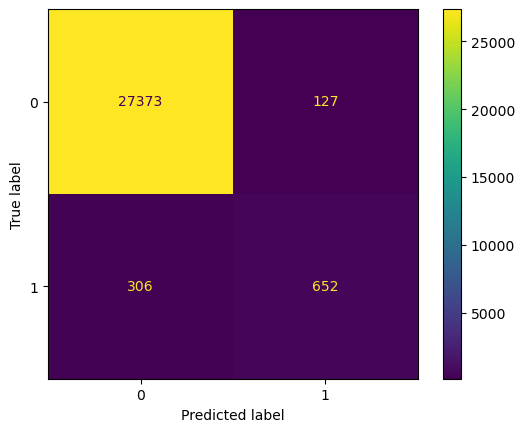

In [37]:
# Confusion matrices with display

print("Confusion matrix on train set : ")
confmat_train = confusion_matrix(Y_train, Y_train_pred)
disp_train = ConfusionMatrixDisplay(confusion_matrix=confmat_train, display_labels=classifier.classes_)
disp_train.plot()
plt.show()
print()
print("Confusion matrix on test set : ")
confmat_test = confusion_matrix(Y_test, Y_test_pred)
disp_test = ConfusionMatrixDisplay(confusion_matrix=confmat_test, display_labels=classifier.classes_)
disp_test.plot()
plt.show()

The confusion matrices indicate that the model generalizes well on the test set, with error proportions similar to the training set. \
The dataset is highly imbalanced (far more non-conversions). **The most frequent error is False Negative (missing a potential subscriber, 306 on the test set)**, rather than False Positive (mis-targeting, 126). \
This suggests the model is more conservative when predicting conversion, and that sensitivity (Recall) should be the priority for further improvement.

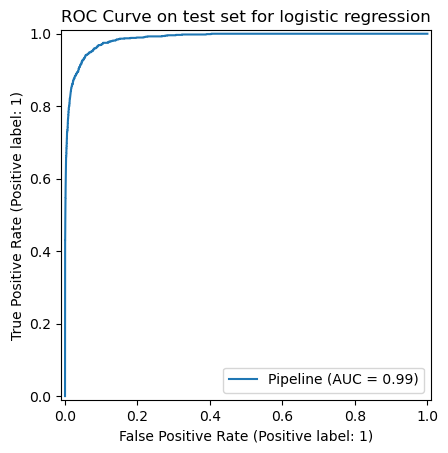

In [43]:
# ROC Curve on test set

_ , ax = plt.subplots() # Throwaway variable (figure_object) not used
ax.set(title="ROC Curve on test set for logistic regression")
RocCurveDisplay.from_estimator(best_pipeline_xgb, X_test, Y_test, ax=ax)
plt.show()

The ROC curve demonstrates **excellent discriminative performance of the model between positive and negative classes**. \
With an **AUC of 0.99 (better than AUC of 0.97 of baseline model)**, the best XGBoost model effectively separates converted from non-converted users on the test set. \
The curve’s proximity to the top-left corner reflects a **strong balance between sensitivity and specificity**.

---

# **PART 4 | Best classifier on all data and predictions on X_without_labels**

In [38]:
# Concatenate our train and test set to train the best XGBoost on all data with labels
X = pd.concat([X_train[features_list], X_test[features_list]], axis=0)
Y = pd.concat([Y_train, Y_test], axis=0)

# Train the best XGBoost model on the entire dataset
best_pipeline_xgb.fit(X, Y)

Pipeline(steps=[('preprocessor',
                 ColumnTransformer(transformers=[('num', StandardScaler(),
                                                  ['age', 'total_pages_visited',
                                                   'pages_per_age',
                                                   'age_x_new_user',
                                                   'age_squared',
                                                   'pages_visited_x_new_user',
                                                   'log_pages_visited']),
                                                 ('cat',
                                                  OneHotEncoder(drop='first',
                                                                handle_unknown='ignore'),
                                                  ['country', 'new_user',
                                                   'source'])])),
                ('classifier',
                 XGBClassifier(base_score=Non...
                               feature_types=None, feature_weights=None,
                               gamma=None, grow_policy=None,
                               importance_type=None,
                               interaction_constraints=None, learning_rate=0.05,
                               max_bin=None, max_cat_threshold=None,
                               max_cat_to_onehot=None, max_delta_step=None,
                               max_depth=6, max_leaves=None,
                               min_child_weight=None, missing=nan,
                               monotone_constraints=None, multi_strategy=None,
                               n_estimators=135, n_jobs=None,
                               num_parallel_tree=None, ...))])

In [39]:
# Assess performance on all data

Y_pred = best_pipeline_xgb.predict(X)
print("XGBoost F1-score on all the data : ", f1_score(Y, Y_pred))

XGBoost F1-score on all the data :  0.7691113234591496


In [ ]:
# Read data without labels
data_without_labels = pd.read_csv('conversion_data_test.csv')
print('Prediction set (without labels):', data_without_labels.shape)

# Features list must match those used in the best classifier
features_list = ['country', 'age', 'new_user',  'source',  'total_pages_visited', 'pages_per_age', 'age_x_new_user', 'age_squared', 'pages_visited_x_new_user', 'log_pages_visited']
  
# Add engineered features before selecting columns
new_user_num = pd.to_numeric(data_without_labels['new_user'], errors='coerce').astype(int)
data_without_labels['pages_per_age'] = data_without_labels['total_pages_visited'] / (data_without_labels['age'] + 1e-6) 
data_without_labels['age_x_new_user'] = data_without_labels['age'] * new_user_num
data_without_labels['age_squared'] = data_without_labels['age'] ** 2
data_without_labels['pages_visited_x_new_user'] = data_without_labels['total_pages_visited'] * new_user_num
data_without_labels['log_pages_visited'] = np.log1p(data_without_labels['total_pages_visited'])

print('Prediction set (without labels) after adding columns:', data_without_labels.shape)

Prediction set (without labels): (31620, 5)
Prediction set (without labels) after adding columns: (31620, 10)


In [41]:
# Use the best pipeline (already fitted) to predict
print("Generating predictions on the unlabeled dataset...")
Y_pred = best_pipeline_xgb.predict(data_without_labels[features_list])
print("...Done.")

# Create the DataFrame for submission
Y_predictions = pd.DataFrame({'converted': Y_pred})

# Export as CSV
file_name = 'conversion_data_test_predictions_sterenn-FE-XGB.csv'
Y_predictions.to_csv(file_name, index=False)

print(f"File saved as '{file_name}' with shape {Y_predictions.shape}")
print(Y_predictions.head())

Generating predictions on the unlabeled dataset...
...Done.
File saved as 'conversion_data_test_predictions_sterenn-FE-XGB.csv' with shape (31620, 1)
   converted
0          1
1          0
2          0
3          0
4          0


---

# **PART 5 | Best model analysis and recommendations**

## 1. Parameters analysis of the best XGBoost model

In [ ]:
# Extraction and visualization of feature importances from the best XGBoost model.

best_xgb_classifier = xgb_gridsearch.best_estimator_.named_steps['classifier']
importances = best_xgb_classifier.feature_importances_

# Construction of final feature names
numeric_cols = ['age', 'total_pages_visited', 'pages_per_age', 'age_x_new_user', 'age_squared', 'pages_visited_x_new_user', 'log_pages_visited']
fitted_preprocessor = xgb_gridsearch.best_estimator_.named_steps['preprocessor']
feature_names_out = fitted_preprocessor.get_feature_names_out() 		# Use get_feature_names_out to retrieve names after OHE
final_features = [name.split('__')[-1] for name in feature_names_out] 	# Delete prefixes "num__" and "cat__" for readability

# Creation of the DataFrame for feature importance
importance_df = pd.DataFrame({
    'feature': final_features,
    'importance': importances
})

importance_df = importance_df.sort_values(by='importance', ascending=False)

# Visualization
fig = px.bar(
    importance_df.head(15).sort_values(by='importance', ascending=True), 
    x='importance',
    y='feature',
    orientation='h',
    height=500,
    title='Features importance (XGBoost)',
    labels={'importance': 'Importance score (F-Score)', 'feature': 'Feature'}
)

fig.update_layout(
    margin=dict(l=250), 
    yaxis_title=None, 
    xaxis_tickformat=".2f"
)

fig.show()

# Checking the importance table
print("\n--- Features importance (XGBoost) ---")
print(importance_df.head(15).to_string(index=False, float_format="%.4f"))


--- Features importance (XGBoost) ---
                 feature  importance
     total_pages_visited      0.8302
          age_x_new_user      0.0572
           pages_per_age      0.0241
         country_Germany      0.0240
              country_UK      0.0210
              country_US      0.0204
pages_visited_x_new_user      0.0068
           source_Direct      0.0063
                     age      0.0053
              source_Seo      0.0045
             age_squared      0.0000
       log_pages_visited      0.0000
              new_user_1      0.0000


The XGBoost model assigns **dominant importance to `total_pages_visited`** (with over 83% of the total feature importance), suggesting it plays a key role in prediction. \
The **second factor**, although significantly less important, is the **interaction between age and new user status** (`age_x_new_user`), highlighting the value of targeting younger users during their initial interaction. \
Other features contribute marginally, and some engineered variables like `age_squared` or `log_pages_visited` show no added value, possibly due to redundancy or low relevance in this context. \
These results should be interpreted with caution: feature importance reflects model structure and does not imply causality.

## 2. Model improvement paths

### 2.1 Addressing class imbalance and decision threshold
The model shows a high number of false negatives (306), meaning it often fails to identify real conversions (low recall). \
Given the dataset’s imbalance, the model appears too conservative. Possible improvements include:

- **Class weight adjustment** – Use XGBoost’s scale_pos_weight parameter to give more importance to the minority class (converted = 1), encouraging the model to predict more positives.
- **Threshold tuning** – Instead of the default 0.5 cutoff, lowering the classification threshold (e.g., to 0.45 or 0.40) could improve recall and capture more potential converters, at the cost of a slight precision decrease.

### 2.2 Enhancing feature engineering
While new features were added, their individual importance remains low, suggesting redundancy or suboptimal encoding. \
Potential refinements:
- **Binning continuous variables** – Convert key variables such as `age` and `total_pages_visited` into ordered categorical bins. This could help capture non-linear relationships (e.g., a sharp drop in conversion after a certain age) more effectively than squared or raw continuous features, and might be more effectively processed by the pipeline's OneHotEncoder.

### 2.3 Strengthening the logistic regression model
Despite its simplicity, logistic regression achieved a solid baseline F1-score and remains more interpretable than XGBoost. \
Focusing on this model could better support the business goal of understanding behavioral levers. \
Recommended optimizations:
- **Regularization tuning** – Use L2 (Ridge) to stabilize coefficients and prevent overfitting, or L1 (Lasso) for automatic feature selection by shrinking less relevant coefficients to zero.
- **Cross-validation** – Apply GridSearchCV to find the optimal regularization strength and obtain a more reliable performance estimate.
- **Targeted fine-tuning** – Adjust regularization based on F1-score optimization; with proper tuning, logistic regression could reach—or even surpass—the predictive performance of XGBoost while offering greater interpretability.

## 3. Marketing team recommendations to improve the conversion rate in the future

### 3.1 Prioritize engagement and traffic retention (conversion funnel)

- Action: **focus on UI and content strategies** to push users to visit at least 10 pages in a session. The conversion rate becomes significant beyond this threshold.
- Levers: **improve internal navigation**, recommend relevant related articles, or introduce subscription incentives (pop-ups, banners) that only activate after the user has passed a certain engagement threshold (e.g., after 5 pages visited) to minimize disruption for casual users.

### 3.2 Demographic targeting: youth and newness

- Action: **allocate ad budget and content efforts towards young users (20-30 years old) who are new users**. The importance of the `age_x_new_user` interaction, combined with the conversion drop after age 30, suggests that this demographic offers a good initial return on investment.
- Levers: **design specific campaigns (e.g., on social media) that target 20-30-year-olds**, guiding them to the most engaging content paths.

### 3.3 Geographical adjustment and low-performer investigation

- Action: **test increasing ad spend or localizing content for the UK and German markets**, which show better correlations with conversion.
- Levers: **conduct a deeper qualitative or web analytics investigation into users in China** (very low/negative correlation) to determine if language barriers, access issues, or content relevance are the root causes of poor performance.